<a href="https://colab.research.google.com/github/clarissachng/ClarissaChngSiEn_COMS30045_IndividualProject/blob/main/1_model_without_human_semantics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install CLIP Dependencies
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git
! pip install clip-anytorch autokeras

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.2 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-axybi4wq
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-axybi4wq
  Resolved https://github.com/openai/CLIP.git to commit ded190a052fdf4585bd685cee5bc96e0310d2c93
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=d1b77de99c95ff564d8cdde1ba953b0c8e9fd07f1fcf21a240ad5397e510572b
  Stored in directory: /tmp/pip-ephem-wheel-cache-xsfioycb/wheels/35/3e/df/3d24cbfb3b6a06f17a2bfd7d1138900d4365d9028aa8f6e92f
Successfully built clip
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.7/124.7 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 16.0 MB/s eta 0:00:00


In [ ]:
taste_desc = {

    "sweet": (
        "A book cover with low angularity and high roundness, featuring curved, smooth, "
        "spherical forms in high reflectional symmetry with few elements. "
        "Soft pink and red hues glow with high pastel brightness and vivid neon candy-like saturation, "
        "rendered in smooth, soft textures with low, simple, clean complexity."
    ),

    "sour": (
        "A book cover with high angularity and sharp, spiky, triangular shapes, "
        "arranged in low asymmetrical symmetry with many cluttered elements. "
        "Acidic green and yellow hues burst with high vivid neon saturation, "
        "cutting across rough, gritty, jagged textures in a piercing, volatile composition."
    ),

    "salty": (
        "A book cover with low-to-medium angularity and low flat, linear roundness, "
        "set in low-to-medium symmetry with few minimalist elements. "
        "Cool blue and white hues shine with high pastel brightness and low desaturated grey saturation, "
        "spread across crystalline and rough textures in a low, simple, clean complexity."
    ),

    "bitter": (
        "A book cover with very high angularity and sharp, spiky, triangular forms of low roundness, "
        "in very low asymmetrical symmetry with many cluttered elements. "
        "Dark olive green, black, brown, and purple hues lurk in low shadowy brightness "
        "with low-to-medium saturation, etched into rough, uneven textures of high intricate, busy complexity."
    ),

    "umami": (
        "A book cover with low angularity and curved, smooth forms, "
        "evoking depth through warm black, brown, purple, and umami red hues. "
        "Low dark shadowy brightness meets medium saturation, "
        "layered into a rich, dense composition of high intricate, busy complexity."
    ),

}

for taste, desc in taste_desc.items():
    tokens = len(desc.split())
    print(f"[{taste}] (~{tokens} words)\n")

[sweet] (~46 words)

[sour] (~42 words)

[salty] (~46 words)

[bitter] (~50 words)

[umami] (~39 words)



In [ ]:
emotion_desc = {

    "happy": (
        "A book cover with low-to-medium angularity and high roundness, "
        "composed in medium symmetry with a medium-density layout. "
        "Cheerful yellow and orange hues radiate with high brightness and high saturation, "
        "flowing across smooth, soft textures in a playful, medium complexity."
    ),

    "pleasure": (
        "A book cover with low angularity and very high roundness, "
        "arranged in high radial symmetry with few low-to-medium elements. "
        "Warm pink and soft red hues glow with high brightness and medium saturation, "
        "draped across smooth, creamy textures in an indulgent, low complexity."
    ),

    "astonished": (
        "A book cover with high spiky starburst angularity and low roundness, "
        "set in low asymmetrical or radial symmetry with many high-density elements. "
        "Neon green and bright yellow hues flash at high contrast with high brightness and vivid saturation, "
        "striking across sharp, rough textures in a high complexity of unexpected forms."
    ),

    "relaxed": (
        "A book cover with low angularity and high roundness, "
        "held in high symmetry with few minimalist elements. "
        "Gentle light blue and white hues drift with high brightness and low pastel saturation, "
        "resting on smooth, silky textures in a serene, low complexity."
    ),

    "satisfied": (
        "A book cover with low angularity and medium roundness, "
        "balanced in high symmetry with few low-density elements. "
        "Warm beige and earthy hues settle with medium-high brightness and medium saturation, "
        "grounded across matte, natural textures in a contented, low complexity."
    ),

    "tired": (
        "A book cover with very low flat horizontal angularity and medium roundness, "
        "resting in medium symmetry with very few sparse elements. "
        "Pale beige, grey, and cream hues hang with medium brightness and very low desaturated saturation, "
        "spread across matte, smooth textures in a minimal, fading complexity."
    ),

    "fear": (
        "A book cover with high spiky angularity and low roundness, "
        "fractured in low asymmetrical symmetry with many cluttered elements. "
        "Black, purple, and grey hues loom with very low brightness and shifting saturation, "
        "clawing through rough, gritty textures in a menacing, high complexity."
    ),

    "angry": (
        "A book cover with high angularity and low roundness, "
        "clashing in low symmetry with many high-density elements. "
        "Fierce red and black accent hues burn with low-to-medium brightness and high saturation, "
        "tearing across rough, scratchy textures in an aggressive, high complexity."
    ),

    "annoyed": (
        "A book cover with high angularity and low roundness, "
        "set in low unbalanced symmetry with many high-density elements. "
        "Clashing orange and green hues collide at medium brightness with high saturation, "
        "grinding across gritty, noisy textures in an irritating, high complexity."
    ),

    "sad": (
        "A book cover with low droopy angularity and medium roundness, "
        "settled in medium symmetry with few empty, low-density elements. "
        "Muted grey and desaturated blue hues fade with low brightness and very low saturation, "
        "together with flat, matte textures in a quiet, low complexity."
    ),

    "disgust": (
        "A book cover with medium angularity and medium roundness, "
        "warped in low asymmetrical symmetry with medium-density elements. "
        "Murky brown and olive green hues fester with low brightness and low-to-medium saturation, "
        "crawling across uneven, sticky textures in a repellent, medium complexity."
    ),

    "droopy": (
        "A book cover with low angularity and low roundness, "
        "repeating in high repetitive symmetry with few low-density elements. "
        "Dull grey and beige hues linger at medium brightness with very low saturation, "
        "sagging across flat textures in a monotonous, very low complexity."
    ),

}

for emotion, desc in emotion_desc.items():
    tokens = len(desc.split())
    print(f"[{emotion}] (~{tokens} words)\n")

[happy] (~39 words)

[pleasure] (~42 words)

[astonished] (~50 words)

[relaxed] (~41 words)

[satisfied] (~39 words)

[tired] (~46 words)

[fear] (~42 words)

[angry] (~40 words)

[annoyed] (~40 words)

[sad] (~43 words)

[disgust] (~40 words)

[droopy] (~41 words)



# Import Libraries and Setup

In [ ]:
import torch
import clip
from PIL import Image
import os
import numpy as np
import matplotlib.pyplot as plt
import kagglehub
import skimage
import IPython.display

from collections import OrderedDict
import torch

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
# Load CLIP model
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model, preprocess = clip.load('ViT-B/32', device=device)

print(f'CLIP model loaded on {device}')

100%|███████████████████████████████████████| 354M/354M [00:04<00:00, 87.9MiB/s]


CLIP model loaded on cuda


# Helper Functions

In [ ]:
def get_prototypes(prompt_sets, model, device):
    """Generate CLIP text embeddings for emotion descriptions"""
    labels = list(prompt_sets.keys())
    all_prompts = [prompt_sets[label] for label in labels]

    # Tokenize and encode
    tokens = clip.tokenize(all_prompts).to(device)
    with torch.no_grad():
        text_features = model.encode_text(tokens)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

    return labels, text_features

# Visualisation Function

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image

def plot_top5_grid(image_paths, labels, prototypes, features, k=5):
    """
    Plots a grid where:
    - Rows = Emotions
    - Columns = The Top k images for that emotion
    - Enforces uniqueness (no image appears twice)
    """

    # Calculate similarity matrix (Emotions x All Images)
    full_sims = (prototypes.cpu() @ features.cpu().T).numpy()

    # Storage for our results
    results = {}
    used_indices = set()

    for i, label in enumerate(labels):
        scores = full_sims[i]
        sorted_indices = scores.argsort()[::-1] # High to low

        top_matches = []
        for idx in sorted_indices:
            if idx not in used_indices:
                score = scores[idx]
                top_matches.append((idx, score))
                used_indices.add(idx)

                if len(top_matches) == k:
                    break

        results[label] = top_matches

    # Plotting the grid
    n_rows = len(labels)
    n_cols = k

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3.5 * n_rows))

    plt.subplots_adjust(wspace=0.1, hspace=0.3)

    for row_idx, label in enumerate(labels):
        matches = results[label]

        for col_idx in range(n_cols):
            ax = axes[row_idx, col_idx]

            if col_idx < len(matches):
                img_idx, score = matches[col_idx]
                path = image_paths[img_idx]

                try:
                    img = Image.open(path).convert("RGB")
                    # Resize to keep file size down and aspect ratio consistent
                    img.thumbnail((200, 300))
                    ax.imshow(img)
                except:
                    ax.text(0.5, 0.5, "Error", ha='center')

                ax.set_title(f"Score: {score:.3f}", fontsize=10)

            ax.axis("off")

            if col_idx == 0:
                ax.text(-0.2, 0.5, label.upper(),
                        transform=ax.transAxes,
                        rotation=90, va='center', ha='right',
                        fontsize=14, fontweight='bold')

    plt.show()

# Download and Load Dataset

In [ ]:
# Download dataset
# dataset_path = kagglehub.dataset_download("lukaanicin/book-covers-dataset")
dataset_path = kagglehub.dataset_download("mexwell/book-cover-dataset")

100%|██████████| 675M/675M [00:06<00:00, 113MB/s] 

Extracting files...


In [ ]:
# Load and encode images
def load_and_encode_from_folder(folder_path, limit=None, batch_size=10000):
    """Recursively finds images and encodes them in batches"""
    image_paths = []

    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_paths.append(os.path.join(root, file))
        #         if limit and len(image_paths) >= limit:
        #             break
        # if limit and len(image_paths) >= limit:
        #     break

    print(f"Found {len(image_paths)} images")

    # Encode in batches
    all_features = []

    for i in range(0, len(image_paths), batch_size):
        batch_paths = image_paths[i:i+batch_size]
        batch_images = []

        for path in batch_paths:
            try:
                img = preprocess(Image.open(path)).unsqueeze(0).to(device)
                batch_images.append(img)
            except Exception as e:
                print(f"Error loading {path}: {e}")

        if batch_images:
            batch_tensor = torch.cat(batch_images)
            with torch.no_grad():
                features = model.encode_image(batch_tensor)
                features = features / features.norm(dim=-1, keepdim=True)
                all_features.append(features)

        print(f"Processed {min(i+batch_size, len(image_paths))}/{len(image_paths)} images")

    all_features = torch.cat(all_features)
    return image_paths, all_features


# Load images (adjust limit as needed)
valid_image_paths, image_features = load_and_encode_from_folder(dataset_path)
print(f"Loaded and encoded {len(valid_image_paths)} images")
print(f"Image features shape: {image_features.shape}")

Found 57000 images
Processed 100/57000 images
Processed 200/57000 images
Processed 300/57000 images
Processed 400/57000 images
Processed 500/57000 images
Processed 600/57000 images
Processed 700/57000 images
Processed 800/57000 images
Processed 900/57000 images
Processed 1000/57000 images
Processed 1100/57000 images
Processed 1200/57000 images
Processed 1300/57000 images
Processed 1400/57000 images
Processed 1500/57000 images
Processed 1600/57000 images
Processed 1700/57000 images
Processed 1800/57000 images
Processed 1900/57000 images
Processed 2000/57000 images
Processed 2100/57000 images
Processed 2200/57000 images
Processed 2300/57000 images
Processed 2400/57000 images
Processed 2500/57000 images
Processed 2600/57000 images
Processed 2700/57000 images
Processed 2800/57000 images
Processed 2900/57000 images
Processed 3000/57000 images
Processed 3100/57000 images
Processed 3200/57000 images
Processed 3300/57000 images
Processed 3400/57000 images
Processed 3500/57000 images
Processed 

# Dataset cleansing

In [ ]:
import urllib.request
import zipfile
import tensorflow as tf

def load_safety_model(clip_model_name="ViT-B/32"):
    """
    Loads a CLIP-embedding-based NSFW classifier
    """
    cache_folder = "./NSFW-cache"
    os.makedirs(cache_folder, exist_ok=True)

    if clip_model_name == "ViT-L/14":
        model_dir = os.path.join(cache_folder, "clip_autokeras_binary_nsfw")
        url_model = "https://raw.githubusercontent.com/LAION-AI/CLIP-based-NSFW-Detector/main/clip_autokeras_binary_nsfw.zip"
        expected_dim = 768
    elif clip_model_name == "ViT-B/32":
        model_dir = os.path.join(cache_folder, "clip_autokeras_nsfw_b32")
        url_model = "https://raw.githubusercontent.com/LAION-AI/CLIP-based-NSFW-Detector/main/clip_autokeras_nsfw_b32.zip"
        expected_dim = 512
    else:
        raise ValueError(f"Unsupported clip_model_name: {clip_model_name}")

    # Download and extract if the folder doesn't exist
    if not os.path.exists(model_dir):
        print(f"Downloading NSFW safety model from {url_model}...")
        zip_path = os.path.join(cache_folder, "model.zip")
        urllib.request.urlretrieve(url_model, zip_path)

        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            zip_ref.extractall(cache_folder)

        os.remove(zip_path)
        print(f"✓ Model downloaded and extracted to {model_dir}")

    # Load the TensorFlow saved model
    safety_model = tf.saved_model.load(model_dir)
    print(f"✓ Safety model loaded (expected dim: {expected_dim})")

    return safety_model, expected_dim


# Load the safety model
safety_model, safety_expected_dim = load_safety_model("ViT-B/32")

✓ Model downloaded and extracted to ./NSFW-cache/clip_autokeras_nsfw_b32
✓ Safety model loaded (expected dim: 512)


In [ ]:
def filter_nsfw(image_paths, image_features, safety_model, expected_dim, threshold=0.5):
    """
    Filter images using TensorFlow NSFW safety model

    Parameters:
    -----------
    image_paths : list
        Paths to images
    image_features : torch.Tensor
        CLIP embeddings for images
    safety_model : TensorFlow model
        Loaded NSFW detection model
    expected_dim : int
        Expected embedding dimension (512 for ViT-B/32)
    threshold : float
        NSFW probability threshold (lower = stricter)

    Returns:
    --------
    filtered_paths : list
        Paths to safe images
    filtered_features : torch.Tensor
        Features for safe images
    nsfw_scores : np.array
        NSFW scores for each image
    """
    if image_features is None:
        return image_paths, image_features, None

    # Convert to TensorFlow format
    emb_np = image_features.detach().cpu().numpy().astype(np.float64)
    emb_tf = tf.convert_to_tensor(emb_np, dtype=tf.float64)

    if emb_tf.shape[1] != expected_dim:
        raise ValueError(f"Embedding dim mismatch: {emb_tf.shape[1]} vs {expected_dim}")

    # Run inference
    serving_fn = safety_model.signatures['serving_default']
    raw_preds = serving_fn(emb_tf)

    # Extract results
    first_key = list(raw_preds.keys())[0]
    preds = raw_preds[first_key].numpy().flatten()

    # Filter based on threshold
    mask_np = preds < threshold
    filtered_paths = [p for p, keep in zip(image_paths, mask_np) if keep]
    filtered_features = image_features[mask_np] if mask_np.any() else None

    num_removed = (~mask_np).sum()
    print(f"✓ Safety model filter: Removed {num_removed}/{len(image_paths)} images")
    print(f"  Threshold: {threshold:.2f}")
    print(f"  Remaining: {len(filtered_paths)} images")

    return filtered_paths, filtered_features, preds

In [ ]:
print("APPLYING NSFW FILTER")

# Store original count
original_count = len(valid_image_paths)

# Filter 1: TensorFlow Safety Model
print("TensorFlow NSFW Safety Model")
SAFETY_THRESHOLD = 0.1  # Lower = stricter (typical range: 0.1-0.5)
image_paths, image_features, nsfw_scores = filter_nsfw(
    valid_image_paths,
    image_features,
    safety_model,
    safety_expected_dim,
    threshold=SAFETY_THRESHOLD
)

APPLYING NSFW FILTER
TensorFlow NSFW Safety Model
✓ Safety model filter: Removed 717/57000 images
  Threshold: 0.10
  Remaining: 56283 images


# Generate Prototypes

In [ ]:
emotion_labels, emotion_prototypes = get_prototypes(emotion_desc, model, device)
taste_labels, taste_prototypes = get_prototypes(taste_desc, model, device)

# Top Books for Each Emotion and Taste

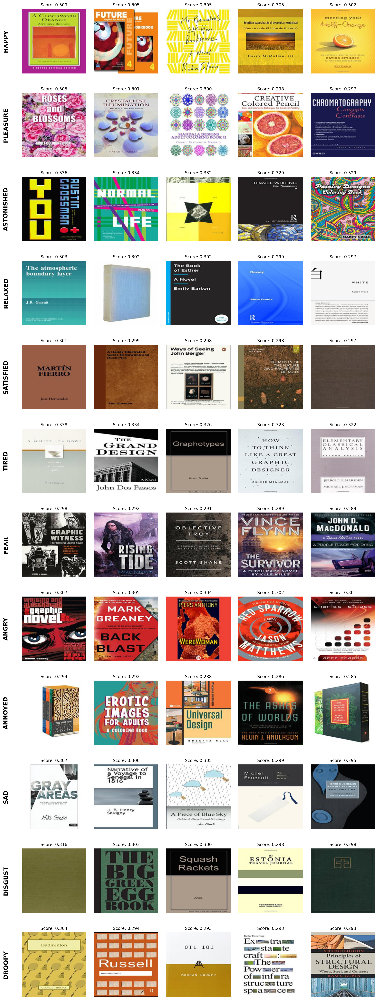

In [ ]:
plot_top5_grid(image_paths, emotion_labels, emotion_prototypes, image_features, k=5)

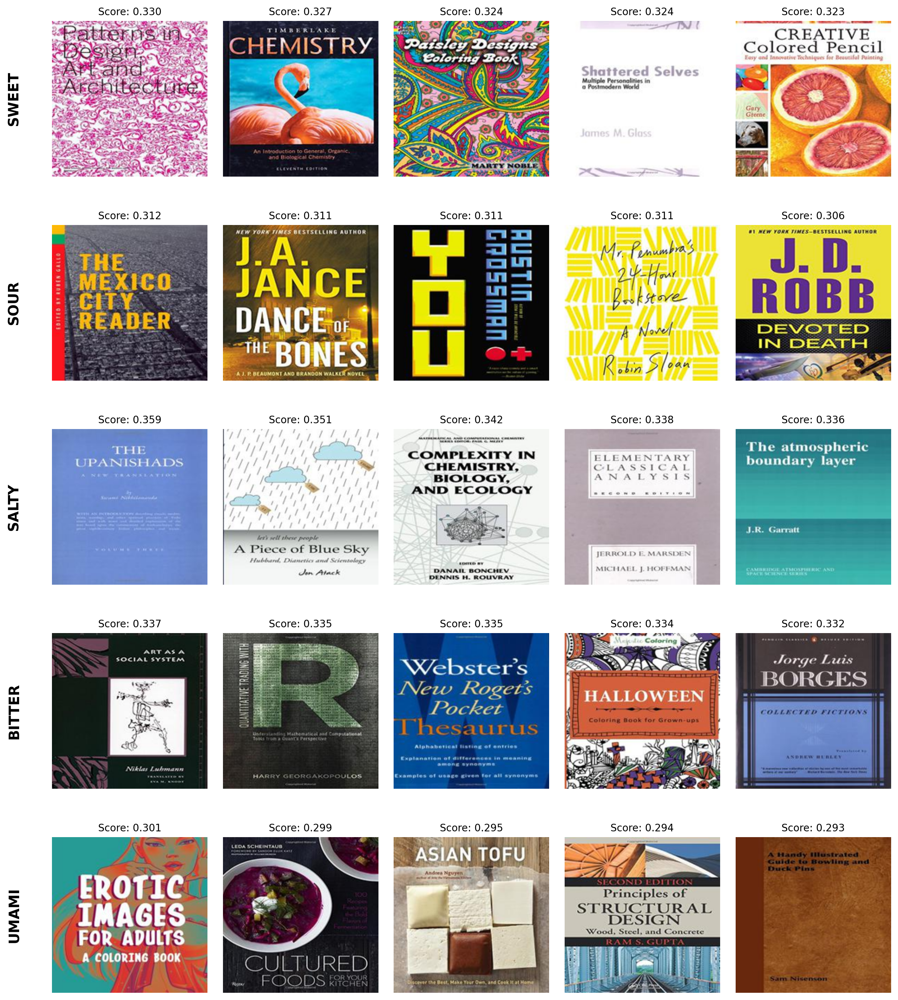

In [ ]:
plot_top5_grid(image_paths, taste_labels, taste_prototypes, image_features, k=5)

# Download the book cover image for user study

In [ ]:
import shutil
import os
from PIL import Image

def save_top5_images(image_paths, labels, prototypes, features, k=5, output_dir="top5_exports", target_width=200):
    os.makedirs(output_dir, exist_ok=True)

    full_sims = (prototypes.cpu() @ features.cpu().T).numpy()

    used_indices = set()

    for i, label in enumerate(labels):
        scores = full_sims[i]
        sorted_indices = scores.argsort()[::-1]

        label_dir = os.path.join(output_dir, label)
        os.makedirs(label_dir, exist_ok=True)

        count = 0
        for idx in sorted_indices:
            if idx not in used_indices:
                score = scores[idx]
                src_path = image_paths[idx]
                ext = os.path.splitext(src_path)[-1].lower() or ".jpg"

                dest_filename = f"{label}_rank{count+1}{ext}"
                dest_path = os.path.join(label_dir, dest_filename)

                # Resizing to target width for user study
                img = Image.open(src_path).convert("RGB")
                aspect_ratio = img.height / img.width
                new_height = int(target_width * aspect_ratio)
                img = img.resize((target_width, new_height), Image.LANCZOS)
                img.save(dest_path)

                used_indices.add(idx)
                count += 1

                if count == k:
                    break

In [ ]:
save_top5_images(image_paths, emotion_labels, emotion_prototypes, image_features, k=5, output_dir="llm_top5_emotions", target_width=350)

In [ ]:
import shutil
from google.colab import files

# Zip the entire parent folder
shutil.make_archive('/content/llm_top5_emotions', 'zip', '/content/llm_top5_emotions')

# Download the zip
files.download('/content/llm_top5_emotions.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>